# 0. Подготовка к работе

In [31]:
import pandas as pd
import numpy as np
import os
from xlrd import open_workbook
import matplotlib.pyplot as plt

In [32]:
path = './task#3'
files_list = os.listdir(path)
event_list = [x for x in files_list if ('2021' in x) or ('2022' in x) or ('2023' in x)]

# 1. Представление и первичная подготовка данных к работе

## 1.1. Данные по событиям

In [33]:
def address_transform(dataframe, column):
    split_columns = dataframe[column].str.split(', ', n=3, expand=True)
    dataframe['location'] = split_columns[0]
    dataframe['streed'] = split_columns[1]
    dataframe['house_num'] = split_columns[2]
    dataframe = dataframe.drop(column, axis=1)
    return dataframe

In [34]:
event_data = pd.DataFrame()
for file in event_list:
    data = pd.read_excel(os.path.join(path, file), header=1)
    event_data = pd.concat([event_data, data])
event_data = event_data.dropna(subset=['Дата текущего показания', 'Текущее потребление, Гкал'])
event_data.columns = ['city', 'number_odpu', 'kind_energy', 'address', 'object_type', 'date', 'cur_consumption_gkal']
event_data.head(5)

,city,number_odpu,kind_energy,address,object_type,date,cur_consumption_gkal
0,Уфа,787,ГВС-ИТП,г Уфа,Другое строение,2023-02-01,188.000
1,Уфа,00119540,ГВС-ИТП,"г Уфа, б-р. Баландина, д.11",Многоквартирный дом,2023-02-01,261.323
2,Уфа,30822,ГВС-ИТП,"г Уфа, б-р. Баландина, д.2",Многоквартирный дом,2023-02-01,459.310
3,Уфа,237959,NaN,"г Уфа, б-р. Баландина, д.2а",Другое строение,2023-02-01,32.872
4,Уфа,145046,ГВС-ИТП,"г Уфа, б-р. Баландина, д.4",Многоквартирный дом,2023-02-01,168.030


## 1.2. Данные по температуре

In [35]:
temperature_data = pd.DataFrame()
temperature_file = 'Температуры, продолжительность ОП.xls'
temperature = open_workbook(os.path.join(path, temperature_file))
sheets = temperature.sheet_names()
event_temperature = pd.DataFrame()
for sheet in sheets[1:]:
    temp_month = pd.read_excel(os.path.join(path, temperature_file), sheet_name=sheet, header=2).iloc[:, 1:]
    temp_month.rename(columns={temp_month.columns[0]: 'Город'}, inplace=True)
    temp_month = temp_month.loc[temp_month['Город'] == 'Уфа']
    temp_month['Месяц'] = range(0, len(temp_month), 1)
    temp_month['Год'] = sheet
    temp_month = temp_month.loc[temp_month['Месяц'] != 0]
    temp_month = pd.melt(temp_month, id_vars=['Город', 'Месяц', 'Год', 'ср-мес', 'с 1 по 10', 'с 11 по 20', 'с 21 по 31'], value_vars=[i for i in range(1, 32, 1)], var_name='День', value_name='t')
    event_temperature = pd.concat([event_temperature, temp_month])
event_temperature.head(5)
event_temperature = event_temperature.dropna(subset=['t'])
event_temperature['Дата'] = pd.to_datetime(dict(year=event_temperature['Год'], month=event_temperature['Месяц'], day=event_temperature['День']), errors='coerce')
event_temperature = event_temperature.dropna(subset=['Дата'])
event_temperature = event_temperature.drop(['Месяц', 'Год', 'День'], axis=1)
event_temperature.columns = ['city', 'month_mean', '1_dec', '2_dec', '3_dec', 't', 'date']
event_temperature.head(5)

,city,month_mean,1_dec,2_dec,3_dec,t,date
0,Уфа,-13.306452,-16.26,-14.5,-9.536364,-5.1,2024-01-01
1,Уфа,-10.706897,-5.99,-14.83,-11.366667,-4.4,2024-02-01
2,Уфа,-2.987097,-6.79,-3.48,0.918182,-6.0,2024-03-01
3,Уфа,12.04,6.48,13.48,16.16,2.2,2024-04-01
4,Уфа,10.180645,6.07,9.75,14.309091,11.1,2024-05-01


## 1.3. Данные по объектам

In [36]:
houses_data = pd.read_excel(os.path.join(path,'Тип строения, этажность, площадь, год постройки.xlsx'), header=1)
houses_data = houses_data.dropna(subset=['Дата постройки'])
houses_data['Дата постройки'] = pd.to_datetime(houses_data['Дата постройки'], errors='coerce')
houses_data['Дата постройки'] = pd.to_datetime(houses_data['Дата постройки'].dt.date, errors='coerce')
houses_data.columns = ['address', 'object_type', 'floors', 'build_date', 'S']
houses_data.head(5)

,address,object_type,floors,build_date,S
0,"г Уфа, б-р. Баландина, д.11",Многоквартирный дом,18,2011-01-01,5394.5
1,"г Уфа, б-р. Баландина, д.2",Многоквартирный дом,16,2012-01-01,12731.5
3,"г Уфа, б-р. Баландина, д.4",Многоквартирный дом,16,2012-01-01,4234.9
4,"г Уфа, б-р. Баландина, д.4 корп.1",Многоквартирный дом,16,2012-01-01,4250.1
5,"г Уфа, б-р. Баландина, д.9",Многоквартирный дом,18,2011-01-01,8213.4


# 2. Подготовка датасета к моделированию

In [37]:
from sklearn.preprocessing import LabelEncoder, StandardScaler
from sklearn.cluster import KMeans
from sklearn.decomposition import PCA
from sklearn.neighbors import NearestNeighbors
from sklearn.metrics import f1_score

## 2.1. Объединение данных

In [38]:
dataset = pd.merge(left=event_data, right=event_temperature, on=['city', 'date'], how='left')
dataset = pd.merge(left=dataset, right=houses_data, on=['address', 'object_type'], how='left')
dataset.head(5)

,city,number_odpu,kind_energy,address,object_type,date,cur_consumption_gkal,month_mean,1_dec,2_dec,3_dec,t,floors,build_date,S
0,Уфа,787,ГВС-ИТП,г Уфа,Другое строение,2023-02-01,188.000,-8.067857,-9.23,-8.5,-6.075,-6.5,NaN,NaT,NaN
1,Уфа,00119540,ГВС-ИТП,"г Уфа, б-р. Баландина, д.11",Многоквартирный дом,2023-02-01,261.323,-8.067857,-9.23,-8.5,-6.075,-6.5,18,2011-01-01,5394.5
2,Уфа,30822,ГВС-ИТП,"г Уфа, б-р. Баландина, д.2",Многоквартирный дом,2023-02-01,459.310,-8.067857,-9.23,-8.5,-6.075,-6.5,16,2012-01-01,12731.5
3,Уфа,237959,NaN,"г Уфа, б-р. Баландина, д.2а",Другое строение,2023-02-01,32.872,-8.067857,-9.23,-8.5,-6.075,-6.5,NaN,NaT,NaN
4,Уфа,145046,ГВС-ИТП,"г Уфа, б-р. Баландина, д.4",Многоквартирный дом,2023-02-01,168.030,-8.067857,-9.23,-8.5,-6.075,-6.5,16,2012-01-01,4234.9


In [39]:
dataset = dataset[['number_odpu', 'kind_energy', 'address', 'object_type', 'date', 'cur_consumption_gkal', 'month_mean', '1_dec', '2_dec', '3_dec', 't']]

# 3. Моделирование c помощью метода кластеризации K-Means

## 3.1. Подготовка датасета

In [40]:
km_dataset = dataset.copy()

In [41]:
km_dataset.sort_values(by=['address', 'date'], inplace=True)
km_dataset['prev_consumption_gkal_1'] = km_dataset.groupby('address')['cur_consumption_gkal'].shift(1)
km_dataset['prev_consumption_gkal_2'] = km_dataset.groupby('address')['cur_consumption_gkal'].shift(2)
km_dataset[['prev_consumption_gkal_1', 'prev_consumption_gkal_2']] = km_dataset[['prev_consumption_gkal_1', 'prev_consumption_gkal_2']].fillna(0)
km_dataset = km_dataset.sort_index()

In [42]:
km_dataset['year'] = km_dataset['date'].dt.year
km_dataset['month'] = km_dataset['date'].dt.month
km_dataset['day'] = km_dataset['date'].dt.day
km_dataset['weekday'] = km_dataset['date'].dt.dayofweek
km_dataset = km_dataset.drop(['date'], axis=1)
km_dataset.head(5)

,number_odpu,kind_energy,address,object_type,cur_consumption_gkal,month_mean,1_dec,2_dec,3_dec,t,prev_consumption_gkal_1,prev_consumption_gkal_2,year,month,day,weekday
0,787,ГВС-ИТП,г Уфа,Другое строение,188.000,-8.067857,-9.23,-8.5,-6.075,-6.5,182.000,146.000,2023,2,1,2
1,00119540,ГВС-ИТП,"г Уфа, б-р. Баландина, д.11",Многоквартирный дом,261.323,-8.067857,-9.23,-8.5,-6.075,-6.5,235.082,161.674,2023,2,1,2
2,30822,ГВС-ИТП,"г Уфа, б-р. Баландина, д.2",Многоквартирный дом,459.310,-8.067857,-9.23,-8.5,-6.075,-6.5,423.110,300.500,2023,2,1,2
3,237959,NaN,"г Уфа, б-р. Баландина, д.2а",Другое строение,32.872,-8.067857,-9.23,-8.5,-6.075,-6.5,34.334,23.607,2023,2,1,2
4,145046,ГВС-ИТП,"г Уфа, б-р. Баландина, д.4",Многоквартирный дом,168.030,-8.067857,-9.23,-8.5,-6.075,-6.5,152.929,105.281,2023,2,1,2


In [43]:
categorical_columns = ['number_odpu', 'kind_energy', 'address', 'object_type', 'year', 'month', 'day', 'weekday']
encoder = LabelEncoder()
for column in categorical_columns:
    km_dataset[column] = encoder.fit_transform(km_dataset[column])

## 3.1. Проведения PCA - Principal Component Analyse

Это статистический метод, который позволяет предоставить данные в меньшем количестве измерений, и при этом сохраняя главные особенности этих данных

In [44]:
pca = PCA(n_components=2)
pca_data = pca.fit_transform(km_dataset)
pca_data = pd.DataFrame(pca_data)
pca_data.head(5)

,0,1
0,1406.107575,-2385.559661
1,-2433.836890,-1685.218971
2,899.202478,-2283.142973
3,401.514363,-2205.300817
4,-751.587919,-1990.644900


In [45]:
km_dataset.index = pca_data.index
km_dataset['pca1'] = pca_data[0]
km_dataset['pca2'] = pca_data[1]
km_dataset.head(5)

,number_odpu,kind_energy,address,object_type,cur_consumption_gkal,month_mean,1_dec,2_dec,3_dec,t,prev_consumption_gkal_1,prev_consumption_gkal_2,year,month,day,weekday,pca1,pca2
0,4098,1,0,7,188.000,-8.067857,-9.23,-8.5,-6.075,-6.5,182.000,146.000,2,1,0,2,1406.107575,-2385.559661
1,193,1,1,13,261.323,-8.067857,-9.23,-8.5,-6.075,-6.5,235.082,161.674,2,1,0,2,-2433.836890,-1685.218971
2,3575,1,2,13,459.310,-8.067857,-9.23,-8.5,-6.075,-6.5,423.110,300.500,2,1,0,2,899.202478,-2283.142973
3,3081,2,3,7,32.872,-8.067857,-9.23,-8.5,-6.075,-6.5,34.334,23.607,2,1,0,2,401.514363,-2205.300817
4,1905,1,4,13,168.030,-8.067857,-9.23,-8.5,-6.075,-6.5,152.929,105.281,2,1,0,2,-751.587919,-1990.644900


## 3.2. Создание модели кластеризации

Создание модели кластеризации, расчёт расстояния от цента кластера и расчёт аномалий с помощью перцентиля дистанций в завесимости от желаемого процентра авыявленных aномалий

In [46]:
kmeans_model = KMeans(n_clusters=15).fit(km_dataset)

In [47]:
def get_distance_by_point(km_dataset, model):
    distance = pd.Series()
    for i in range(len(km_dataset)):
        x_a = np.array(km_dataset.loc[i])
        x_b = model.cluster_centers_[model.labels_[i] - 1]
        distance.at[i] = np.linalg.norm(x_a - x_b)
    return distance

In [48]:
percent_anomalies = 2

dist = get_distance_by_point(km_dataset, kmeans_model)
km_dataset['cluster'] = kmeans_model.predict(km_dataset)

n_outliers = int((percent_anomalies / 100) * len(dist))
threshold = np.percentile(dist, 100 - percent_anomalies)

km_output = dataset.copy()

event_data['anomaly_cluster'] = (dist >= threshold).astype(int)
event_data.head(5)

,city,number_odpu,kind_energy,address,object_type,date,cur_consumption_gkal,anomaly_cluster
0,Уфа,787,ГВС-ИТП,г Уфа,Другое строение,2023-02-01,188.000,0
1,Уфа,00119540,ГВС-ИТП,"г Уфа, б-р. Баландина, д.11",Многоквартирный дом,2023-02-01,261.323,0
2,Уфа,30822,ГВС-ИТП,"г Уфа, б-р. Баландина, д.2",Многоквартирный дом,2023-02-01,459.310,0
3,Уфа,237959,NaN,"г Уфа, б-р. Баландина, д.2а",Другое строение,2023-02-01,32.872,0
4,Уфа,145046,ГВС-ИТП,"г Уфа, б-р. Баландина, д.4",Многоквартирный дом,2023-02-01,168.030,0


In [49]:
event_data['anomaly_cluster'] = event_data['anomaly_cluster'].astype(bool)
#event_data.to_csv('anomaly.csv', index=False)

In [50]:
event_data.to_csv('anomaly.csv', index=False)

## 3.3. Представление модели кластеризации на графике

### 3.3.1. Построение общего графика

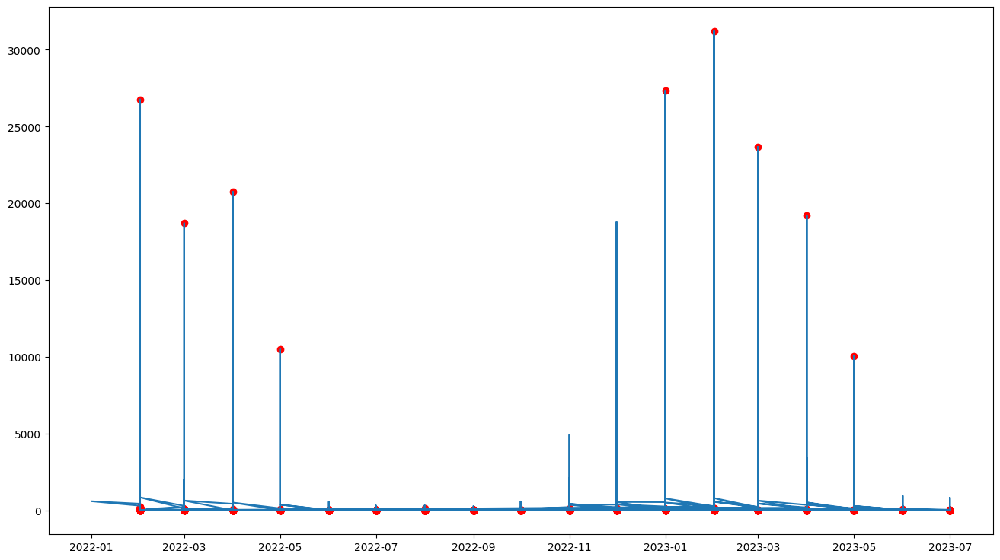

In [250]:
fig, ax = plt.subplots(figsize=(16, 9))
c = 'cur_consumption_gkal'
a = km_output.loc[km_output['anomaly_cluster'] == 1, [c, 'date']]

ax.plot(km_output['date'], km_output[c])
ax.scatter(a.date, a[c], color = 'red')
plt.show()

### 3.3.2. Построение графика по домам

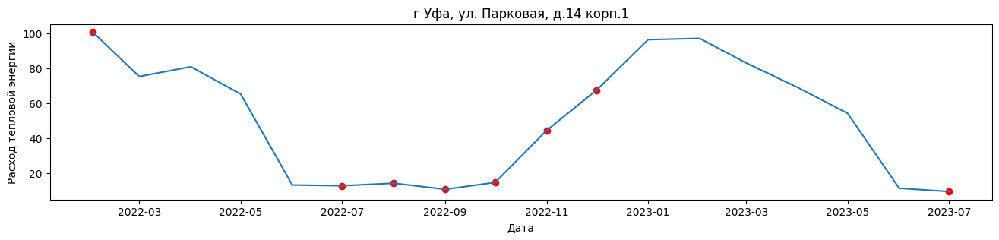

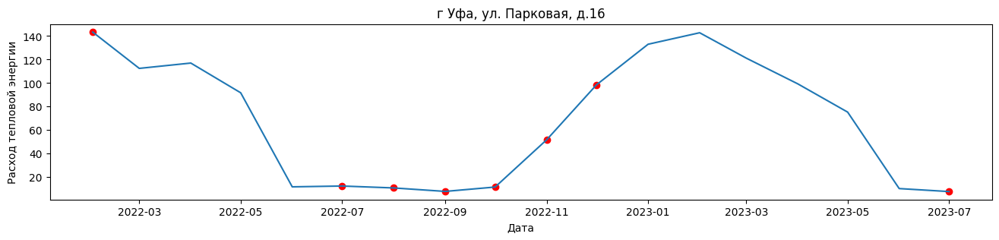

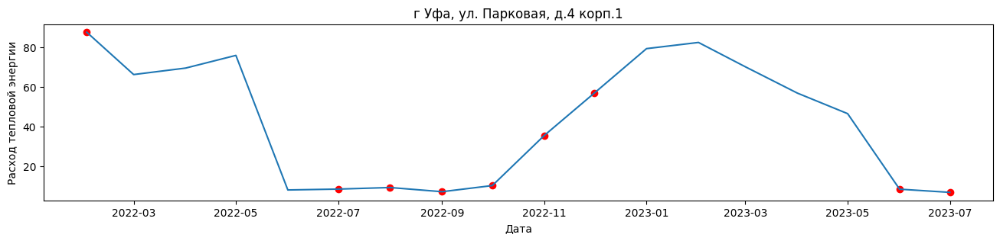

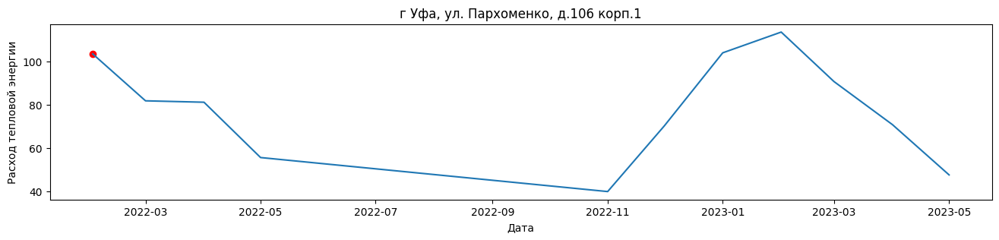

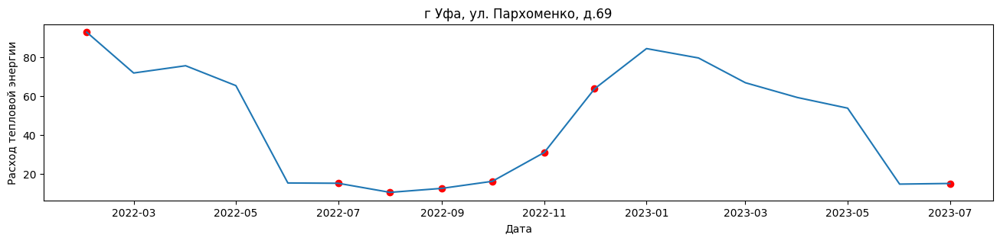

...

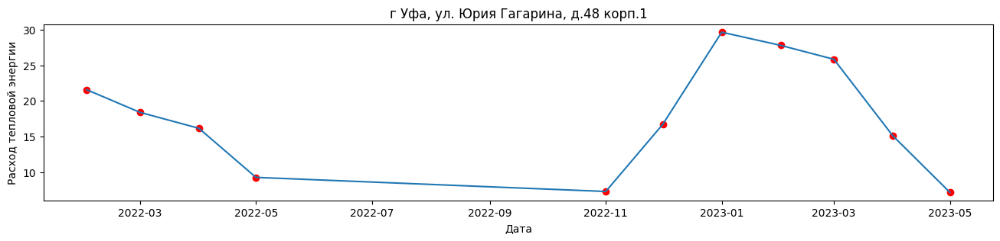

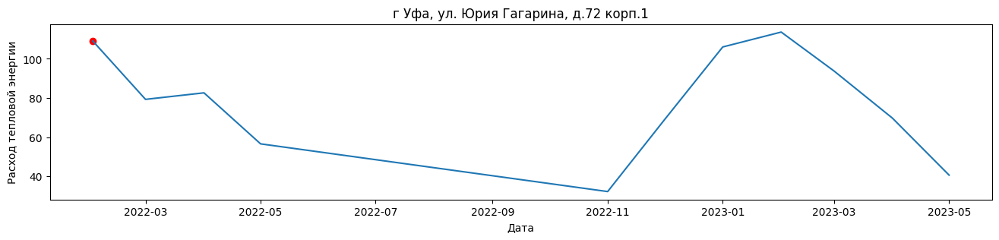

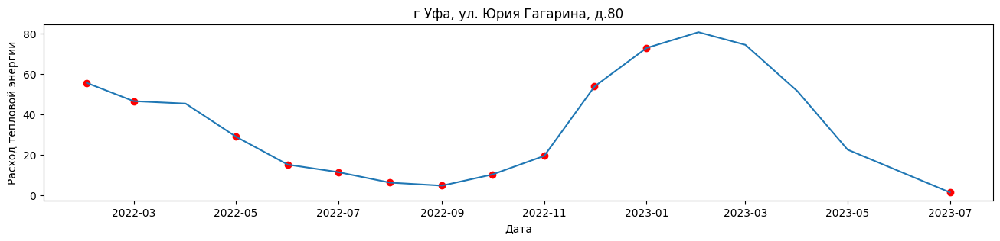

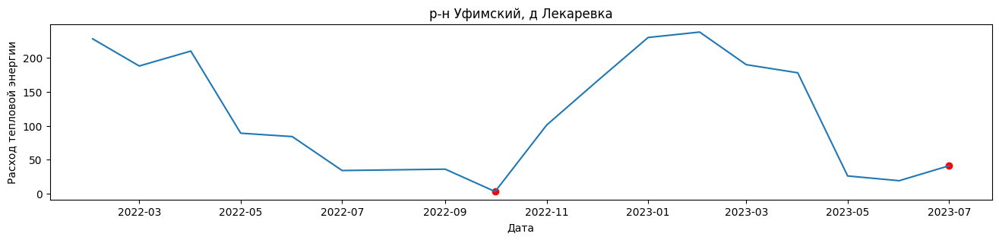

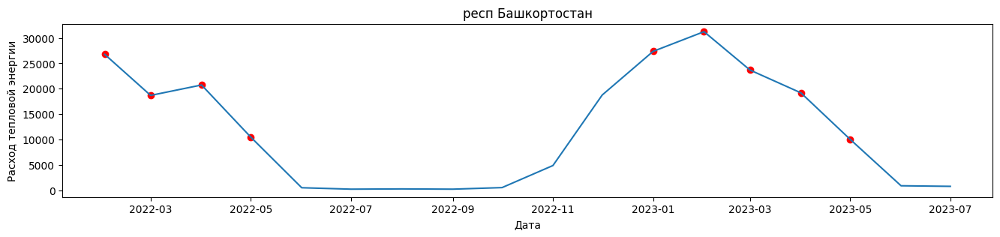

In [251]:
houses = sorted(km_output['address'].unique())

for house in houses:
    c = 'cur_consumption_gkal'
    ds = km_output.loc[km_output['address'] == house].sort_values(by='date', ascending=True)
    a = ds.loc[km_output['anomaly_cluster'] == 1, [c, 'date']]
    if a.shape[0] > 0:
        fig, ax = plt.subplots(figsize=(16, 3))
        ax.plot(ds.date, ds[c])
        ax.scatter(a.date, a[c], color = 'red')
        ax.set_title(house)
        ax.set_xlabel('Дата')
        ax.set_ylabel('Расход тепловой энергии')
        plt.show()

## 3.4. Проверка выявления аномалий

In [252]:
y_test = np.ones(km_output.loc[km_output['cur_consumption_gkal'] <= 1].shape[0])
y_pred = km_output.loc[km_output['cur_consumption_gkal'] <= 1]['anomaly_cluster'].to_list()
print(f1_score(y_test, y_pred))

0.22641509433962265


# 4. Моделирование с помощью нейронных сетей

In [197]:
import tensorflow as tf
from sklearn.preprocessing import StandardScaler
from sklearn.model_selection import train_test_split

## 4.1. Подготовка датасета

In [220]:
nn_dataset = dataset.copy()

In [221]:
RANDOM_SEED = 42
VALIDATE_SIZE = 0.2

X = nn_dataset.drop(['cur_consumption_gkal'], axis=1)
y = nn_dataset['cur_consumption_gkal']

X['year'] = X['date'].dt.year
X['month'] = X['date'].dt.month
X['day'] = X['date'].dt.day
X['weekday'] = X['date'].dt.dayofweek
X = X.drop(['date'], axis=1)


In [223]:
X_transformed = X.copy()

categorical_columns = ['number_odpu', 'kind_energy', 'address', 'object_type', 'year', 'month', 'day', 'weekday']
encoder = LabelEncoder()
for column in categorical_columns:
    X_transformed[column] = encoder.fit_transform(X[column])


## 4.2. Настройка модели

In [224]:
input_dim = X_transformed.shape[1]
BATCH_SIZE = 256
EPOCHS = 100

autoencoder = tf.keras.models.Sequential([
    tf.keras.layers.Dense(input_dim, activation='elu', input_shape=(input_dim, )), 
    tf.keras.layers.Dense(16, activation='elu'),
    tf.keras.layers.Dense(8, activation='elu'),
    tf.keras.layers.Dense(4, activation='elu'),
    tf.keras.layers.Dense(2, activation='elu'),
    
    # reconstruction / decode
    tf.keras.layers.Dense(2, activation='elu'),
    tf.keras.layers.Dense(4, activation='elu'),
    tf.keras.layers.Dense(8, activation='elu'),
    tf.keras.layers.Dense(16, activation='elu'),
    tf.keras.layers.Dense(input_dim, activation='elu')
])

autoencoder.compile(optimizer="adam", 
                    loss="mse",
                    metrics=["acc"])

autoencoder.summary()

/Users/mishafoniakov/Documents/Hackatons/Anomaly/anomaly/lib/python3.11/site-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


Model: "sequential"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ dense (Dense)                   │ (None, 13)             │           182 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_1 (Dense)                 │ (None, 16)             │           224 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_2 (Dense)                 │ (None, 8)              │           136 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_3 (Dense)                 │ (None, 4)              │            36 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_4 (Dense)                 │ (None, 2)              │            10 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_5 (Dense)                 │ (None, 2)              │             6 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_6 (Dense)                 │ (None, 4)              │            12 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_7 (Dense)                 │ (None, 8)              │            40 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_8 (Dense)                 │ (None, 16)             │           144 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_9 (Dense)                 │ (None, 13)             │           221 │
└─────────────────────────────────┴────────────────────────┴───────────────┘

 Total params: 1,011 (3.95 KB)

 Trainable params: 1,011 (3.95 KB)

 Non-trainable params: 0 (0.00 B)

## 4.3. Обучение модели

In [225]:
history = autoencoder.fit(
    X_transformed, y,
    shuffle=True,
    epochs=EPOCHS,
    batch_size=BATCH_SIZE
)

Epoch 1/100
215/215 ━━━━━━━━━━━━━━━━━━━━ 2s 1ms/step - acc: 1.1466e-05 - loss: 132186.1875
Epoch 2/100
215/215 ━━━━━━━━━━━━━━━━━━━━ 0s 954us/step - acc: 2.6726e-05 - loss: 177166.2031
Epoch 3/100
215/215 ━━━━━━━━━━━━━━━━━━━━ 0s 939us/step - acc: 2.5108e-05 - loss: 83112.0625
Epoch 4/100
215/215 ━━━━━━━━━━━━━━━━━━━━ 0s 948us/step - acc: 9.7641e-05 - loss: 171260.4375
Epoch 5/100
215/215 ━━━━━━━━━━━━━━━━━━━━ 0s 979us/step - acc: 8.6644e-05 - loss: 154836.8906
Epoch 6/100
215/215 ━━━━━━━━━━━━━━━━━━━━ 0s 963us/step - acc: 3.5437e-05 - loss: 149989.2812
Epoch 7/100
215/215 ━━━━━━━━━━━━━━━━━━━━ 0s 964us/step - acc: 1.5696e-04 - loss: 164730.7188
Epoch 8/100
215/215 ━━━━━━━━━━━━━━━━━━━━ 0s 951us/step - acc: 2.6986e-06 - loss: 136060.9531
Epoch 9/100
215/215 ━━━━━━━━━━━━━━━━━━━━ 0s 984us/step - acc: 8.7258e-06 - loss: 135332.3125
Epoch 10/100
215/215 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step - acc: 2.3813e-05 - loss: 138583.4844
Epoch 11/100
215/215 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step - acc: 8.5606e-05 - 

## 4.4. Прогноз расхода тепла по модели и работа с прогнозом

Прогнозирование расчёта тепла, вычисление средней квадратичной ошибки

In [226]:
reconstructions = autoencoder.predict(X_transformed) 

1713/1713 ━━━━━━━━━━━━━━━━━━━━ 1s 709us/step


In [227]:
mse = np.mean(np.power(X_transformed - reconstructions, 2), axis=1)

## 4.5. Создание алгоритма выявления аномалий

Расчёт по формуле индекса аномалии и его сравнение с заданным порогом

In [228]:
THRESHOLD = 3

def mad_score(points):
    m = np.median(points)
    ad = np.abs(points - m)
    mad = np.median(ad)
    
    return ad / mad

z_scores = mad_score(mse)
nn_dataset['outliers'] = z_scores > THRESHOLD

## 4.6. Представление модели на графике

### 4.6.1. Построение общего графика

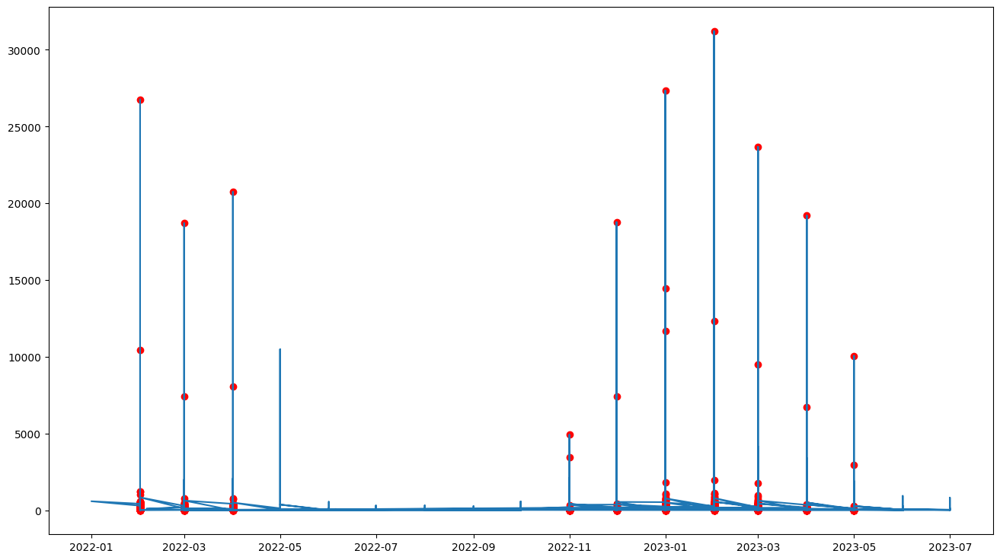

In [140]:
nn_dataset['date'] = pd.to_datetime(dict(year=nn_dataset['year'], month=nn_dataset['month'], day=nn_dataset['day']))

fig, ax = plt.subplots(figsize=(16, 9))
c = 'cur_consumption_gkal'
a = km_dataset.loc[nn_dataset['outliers'] == True, [c, 'date']]

ax.plot(nn_dataset.date, nn_dataset[c])
ax.scatter(a.date, a[c], color = 'red')
plt.show()

### 4.6.2. Построение графиков по домам

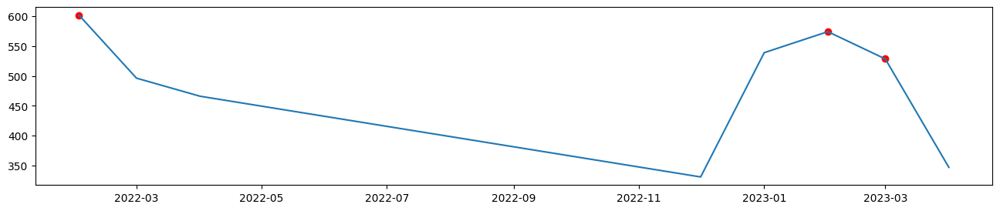

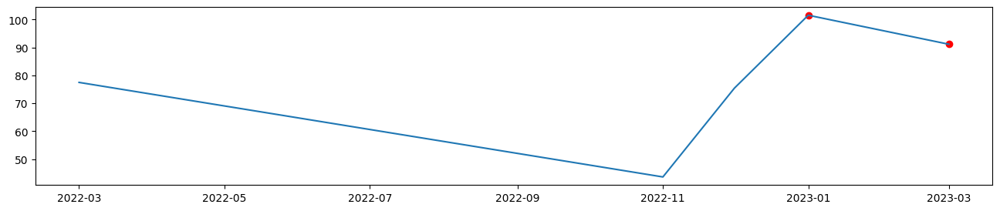

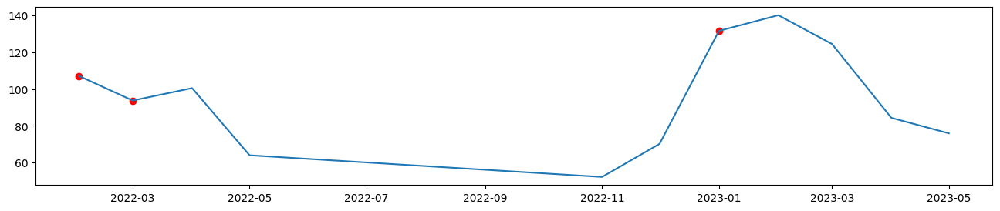

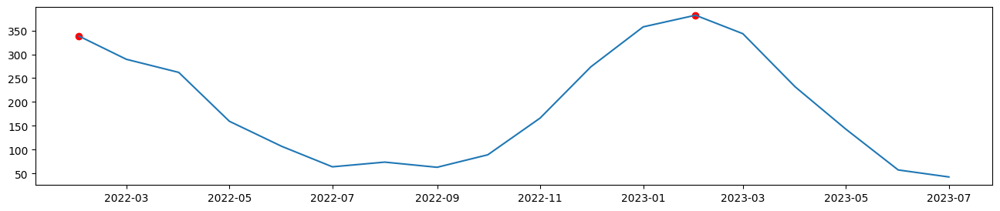

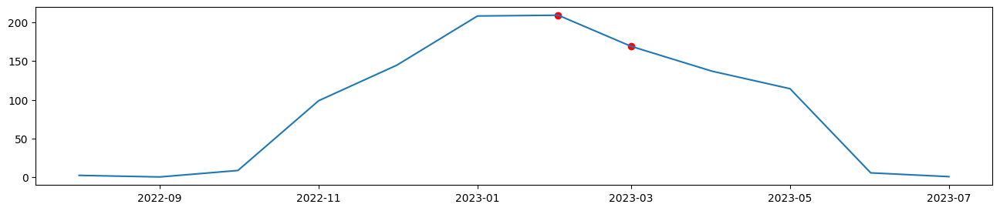

...

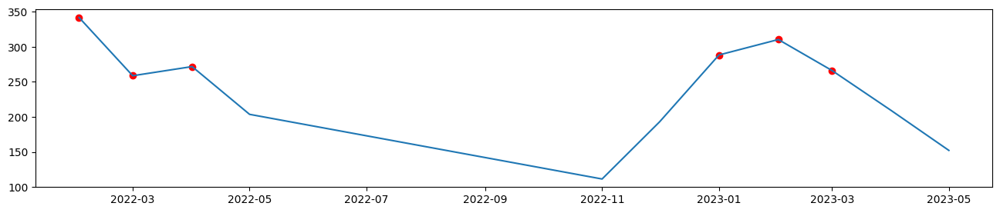

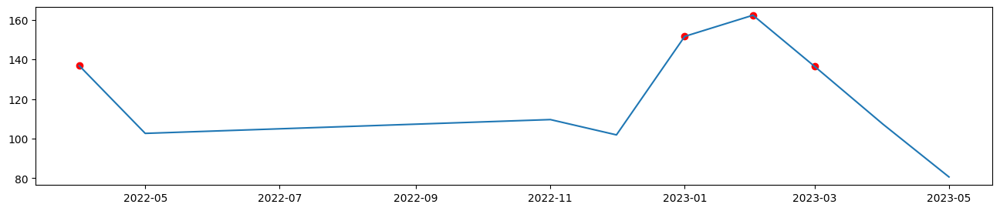

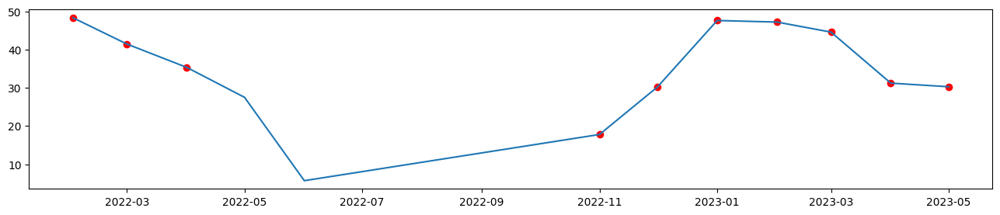

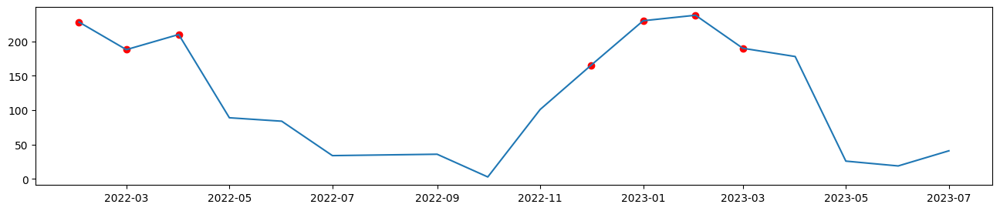

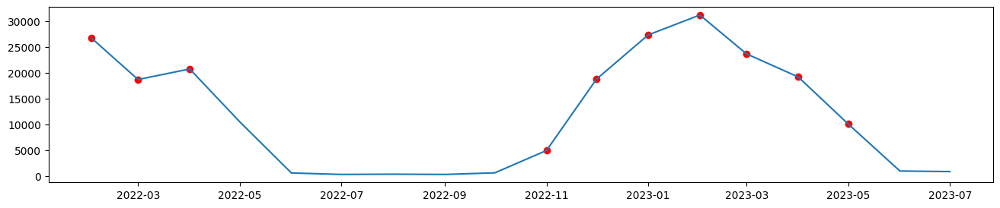

In [141]:
houses = sorted(nn_dataset['address'].unique())

for house in houses:
    c = 'cur_consumption_gkal'
    ds = nn_dataset.loc[nn_dataset['address'] == house].sort_values(by='date', ascending=True)
    a = ds.loc[nn_dataset['outliers'] == True, [c, 'date']]
    if a.shape[0] > 0:
        fig, ax = plt.subplots(figsize=(16, 3))
        ax.plot(ds.date, ds[c])
        ax.scatter(a.date, a[c], color = 'red')
        plt.show()

## 4.7. Тестирование модели

In [229]:
nn_dataset['outliers'].value_counts()

outliers
False    53111
True      1694
Name: count, dtype: int64

In [231]:
y_test = np.ones(nn_dataset.loc[nn_dataset['cur_consumption_gkal'] <= 1].shape[0])
y_pred = nn_dataset.loc[nn_dataset['cur_consumption_gkal'] <= 1]['outliers'].to_list()
print(f1_score(y_test, y_pred))

0.041666666666666664


# 5. Загрузка результатов лучшей модели